# Problem
The main problem that we are working on is to remove noise from images. The images that are captured in the real world come with a lot of noise. So there is a need to remove these noise from images when it comes to low level vision tasks and similar applications.<br>

So, in this case study, we are trying to build a model that can remove noise from real world noisy images.

#Why Deep Learning?
This task of image denoising has been an interesting area of research since decades. Over the years many techniques and ideas have been introduced for image denoising. <br>

Most of these techniques assumed these noise in images to be gaussian noise or impulse noise. But this assumption doesn't completely hold true for real noise in photographs. The real world noise is more sophisticated and diverse. Due to this most of these techniques performed poorly in completely removing real noise from images. <br>

To tackle this issue of denoising on real world noisy images, there is a need of using a more advanced teachnique with more realistic noise on real-world noisy-clean image pairs. This is where deep learning comes into picture and experiments have proved that training a convolutional blind denoising deep learning network outperforms other techniques in image denoising tasks by a large margin. This is why we use deep learning for image denosing tasks. 


# Constraints
1. Denoise real world noisy images as close to the ground truth image.
2. No latency constraint. The priority is to denoise the image as close to the ground truth as possible, even if it takes reasonable amount of time.

# Performance Metric
We will use __Peak Signal to Noise Ratio (PSNR)__ as the performance metric.<br>
PSNR is one famous metric used to measure image quality. It is the ratio of maximum possible power of a signal and the power of corrupting noise that aﬀects the quality of its representation. Since signals can take a wide range of values, PSNR is usually expressed in logarithmic decibel scale.<br>
Mathematically PSNR can be represented as




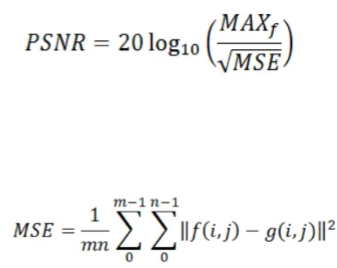

where,<br>
MAXf = maximum signal value that exists in our original image<br>
g = Ground truth image<br>
f = Noisy image<br>
m = no of rows of pixels and i represents the index of that row.<br>
n = no of columns of pixels and j represents the index of that column

# Dataset Overview
We will be using the two publicly available dataset for this case study. <br>

RENOIR Dataset :- A Dataset for Real Low-Light Image Noise Reduction.<br>
We will take 221 clean-noisy image pairs from this dataset 

In [1]:
!pip install patchify

In [2]:
#Importing relevant libraries
import os
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from patchify import patchify, unpatchify
import seaborn as sns
import random
import numpy as np
import math
from sklearn.model_selection import train_test_split
import pickle
import tensorflow as tf
from tensorflow.keras.callbacks import LearningRateScheduler,ReduceLROnPlateau
from tensorflow.keras import models, layers
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, BatchNormalization, Activation, Flatten, Dense, Input, MaxPooling2D, Add, Reshape, concatenate, AveragePooling2D, Multiply, GlobalAveragePooling2D, UpSampling2D, MaxPool2D,Softmax
from tensorflow.keras.activations import softmax
from tensorflow.keras import initializers, regularizers
from tensorflow.keras.optimizers import Adam
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
%load_ext tensorboard

## Extracting Image paths for RENOIR Dataset

In [3]:
df = pd.DataFrame()
dir = os.listdir('/kaggle/input/renoir/GroundTruth')
GT = []
Nsy=[]
for image in dir:
    GT.append('/kaggle/input/renoir/GroundTruth/'+image)

dir = os.listdir('/kaggle/input/renoir/Noisy')
for image in dir:
  Nsy.append('/kaggle/input/renoir/Noisy/'+image)

df['Ground Truth Images'] = GT
df['Noisy Images'] = Nsy
df.head()

,Ground Truth Images,Noisy Images
0,/kaggle/input/renoir/GroundTruth/129.bmp,/kaggle/input/renoir/Noisy/129.bmp
1,/kaggle/input/renoir/GroundTruth/184.bmp,/kaggle/input/renoir/Noisy/184.bmp
2,/kaggle/input/renoir/GroundTruth/65.bmp,/kaggle/input/renoir/Noisy/65.bmp
3,/kaggle/input/renoir/GroundTruth/209.bmp,/kaggle/input/renoir/Noisy/209.bmp
4,/kaggle/input/renoir/GroundTruth/133.bmp,/kaggle/input/renoir/Noisy/133.bmp


In [4]:
df.shape

(221, 2)

# Exploratory Data Analysis

## Image Sizes

In [5]:
size=[]
for i in range(len(df)):
    img_gt = cv2.imread(df['Ground Truth Images'].iloc[i])
    size.append(img_gt.shape)

In [6]:
df['image size'] = size
df['image size'] = df['image size'].astype(str)
df.head()

,Ground Truth Images,Noisy Images,image size
0,/kaggle/input/renoir/GroundTruth/129.bmp,/kaggle/input/renoir/Noisy/129.bmp,"(2760, 3684, 3)"
1,/kaggle/input/renoir/GroundTruth/184.bmp,/kaggle/input/renoir/Noisy/184.bmp,"(3465, 5197, 3)"
2,/kaggle/input/renoir/GroundTruth/65.bmp,/kaggle/input/renoir/Noisy/65.bmp,"(3000, 3000, 3)"
3,/kaggle/input/renoir/GroundTruth/209.bmp,/kaggle/input/renoir/Noisy/209.bmp,"(3465, 5199, 3)"
4,/kaggle/input/renoir/GroundTruth/133.bmp,/kaggle/input/renoir/Noisy/133.bmp,"(2760, 3684, 3)"


Text(0, 0.5, 'No. of images')

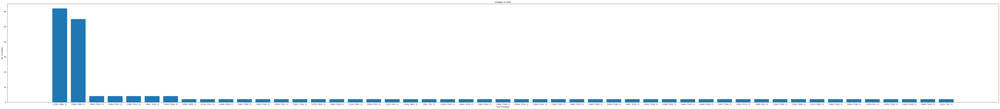

In [7]:
fig = plt.figure(figsize = (100, 10))
y = list(df['image size'].value_counts())
x = df['image size'].value_counts().index.tolist()
plt.bar(x,y)
plt.title("Images vs Size")
plt.xlabel("Size of images")
plt.ylabel("No. of images")

Observation : Most number of images have size (2760 x 3684).

## Displaying few clean-noisy image pairs

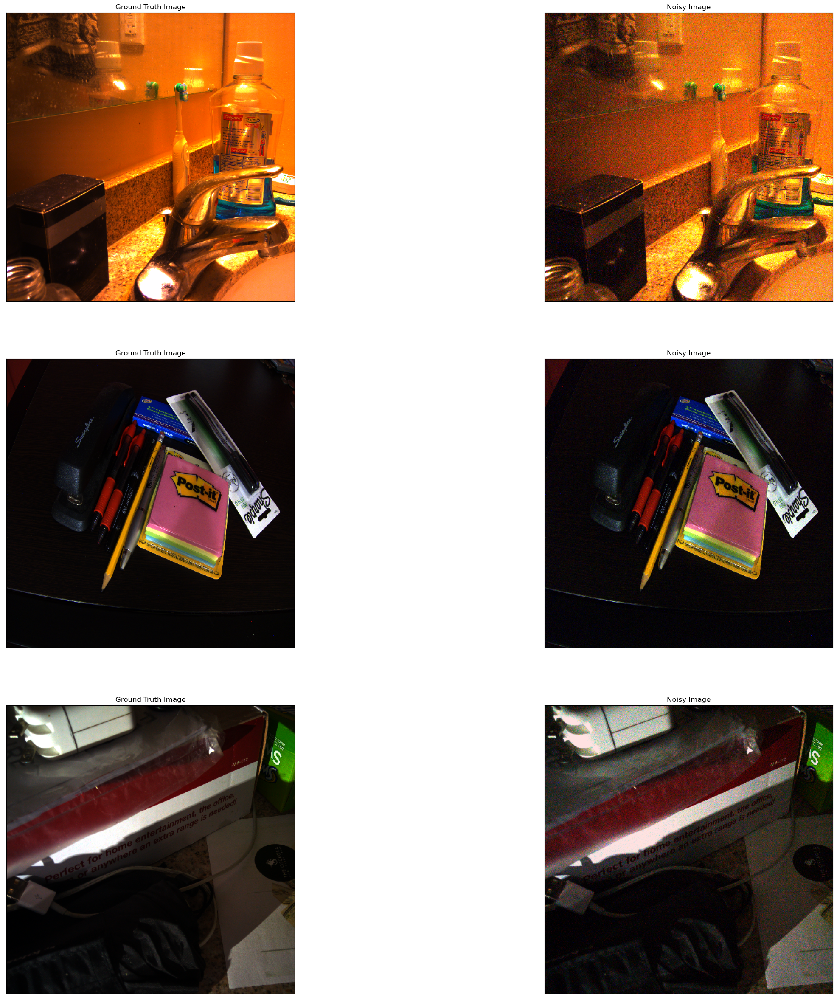

In [8]:
sample = df.sample(3)
fig, ax = plt.subplots(len(sample),2,figsize=(30,30))
for i in range(len(sample)):
    img = cv2.imread(sample['Ground Truth Images'].iloc[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(512,512))
    ax[i][0].imshow(img)
    ax[i][0].get_xaxis().set_visible(False)
    ax[i][0].get_yaxis().set_visible(False)
    ax[i][0].title.set_text("Ground Truth Image")
  
    img = cv2.imread(sample['Noisy Images'].iloc[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(512,512))
    ax[i][1].imshow(img)
    ax[i][1].get_xaxis().set_visible(False)
    ax[i][1].get_yaxis().set_visible(False)
    ax[i][1].title.set_text("Noisy Image")

Observation : One can see, there is significant amount of noise in the nosiy images and the ground truth images shows the corresponding clean images free from noise. <br>


## Splitting the dataset into train and test datasets

In [9]:
X = df['Noisy Images']
y = df['Ground Truth Images']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [10]:
#Storing the image patches as pickle files
import pickle
pickle.dump((X_train,y_train),open('train_path.pkl','wb'))
pickle.dump((X_test,y_test),open('test_path.pkl','wb'))

In [11]:
X_train, y_train = pickle.load(open('/kaggle/working/train_path.pkl', 'rb'))
X_test,y_test = pickle.load(open('/kaggle/working/test_path.pkl', 'rb'))

In [12]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(176,)
(176,)
(45,)
(45,)


##Creating Patches

In [13]:
def patches(img,patch_size):
    patches = patchify(img, (patch_size, patch_size, 3), step=patch_size)
    return patches

In [14]:
sample = pd.DataFrame({'Ground Truth Images':['a','/kaggle/input/renoir/GroundTruth/129.bmp'], 'Noisy Images':['b','/kaggle/input/renoir/Noisy/129.bmp']})
sample

,Ground Truth Images,Noisy Images
0,a,b
1,/kaggle/input/renoir/GroundTruth/129.bmp,/kaggle/input/renoir/Noisy/129.bmp


In [15]:
#Creating patches for a Ground Truth Image
path = sample['Ground Truth Images'].iloc[1]
img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print('Image shape: {}'.format(img.shape))

patches_gt = patches(img,256)
print('Patch shape: {}'.format(patches_gt.shape))

Image shape: (2760, 3684, 3)
Patch shape: (10, 14, 1, 256, 256, 3)


In [16]:
#Creating patches for a Noisy Image
path = sample['Noisy Images'].iloc[1]
img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print('Image shape: {}'.format(img.shape))

patches_nsy = patches(img,256)
print('Patch shape: {}'.format(patches_nsy.shape))

Image shape: (2760, 3684, 3)
Patch shape: (10, 14, 1, 256, 256, 3)


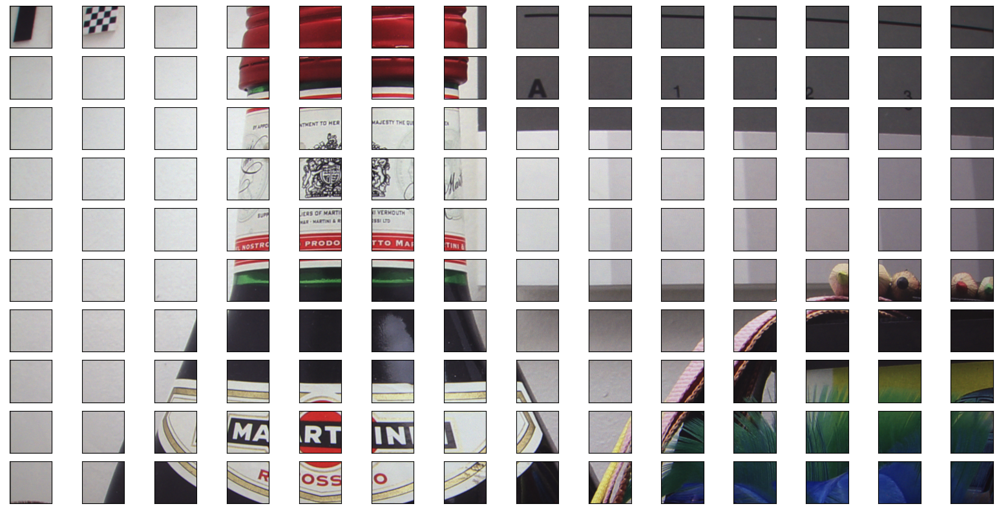

In [17]:
rows = patches_nsy.shape[0]
cols = patches_nsy.shape[1]
fig, axs = plt.subplots(rows,cols,figsize=(20,10))
for i in range(rows):
    for j in range(cols):
        axs[i][j].imshow(patches_gt[i][j][0])
        axs[i][j].get_xaxis().set_visible(False)
        axs[i][j].get_yaxis().set_visible(False)

This is what patches does. It splits the images into different patches based on a given patch size.

We can clearly see the difference between ground truth image patches and noisy image patches. There is significant amount on noisy in the noisy image patches and this is what we are trying to remove. <br>

We will be creating patches for all the images. Experiments have shown that splitting images into patches and using these patches for training improve model performance in denoising. In regard to that, we will resize all the images to a fixed size of 1024 x 1024 and create patches with patch size 256 x 256.

In [18]:
# Creating patches for X_train and y_train
X_train_patches = []
y_train_patches = []
for i in range(len(X_train)):
    path = X_train.iloc[i]
    img_nsy = cv2.imread(path)
    img_nsy = cv2.cvtColor(img_nsy, cv2.COLOR_BGR2RGB)
    img_nsy = cv2.resize(img_nsy,(1024,1024))  #resizing the X_train images
    patches_nsy = patches(img_nsy,256)
    path = y_train.iloc[i]
    img_gt = cv2.imread(path)
    img_gt = cv2.cvtColor(img_gt, cv2.COLOR_BGR2RGB)
    img_gt = cv2.resize(img_gt,(1024,1024))  #resizing the y_train images
    patches_gt = patches(img_gt,256)
    rows = patches_nsy.shape[0]
    cols = patches_nsy.shape[1]
    for j in range(rows):
        for k in range(cols):
            X_train_patches.append(patches_nsy[j][k][0])
            y_train_patches.append(patches_gt[j][k][0])
X_train = np.array(X_train_patches)
y_train = np.array(y_train_patches)

In [19]:
# Creating patches for X_test and y_test
X_test_patches = []
y_test_patches = []
for i in range(len(X_test)):
    path = X_test.iloc[i]
    img_nsy = cv2.imread(path)
    img_nsy = cv2.cvtColor(img_nsy, cv2.COLOR_BGR2RGB)
    img_nsy = cv2.resize(img_nsy,(1024,1024))  #resizing the X_test images
    patches_nsy = patches(img_nsy,256)
    path = y_test.iloc[i]
    img_gt = cv2.imread(path)
    img_gt = cv2.cvtColor(img_gt, cv2.COLOR_BGR2RGB)
    img_gt = cv2.resize(img_gt,(1024,1024))  #resizing the y_test images
    patches_gt = patches(img_gt,256)
    rows = patches_nsy.shape[0]
    cols = patches_nsy.shape[1]
    for j in range(rows):
        for k in range(cols):
            X_test_patches.append(patches_nsy[j][k][0])
            y_test_patches.append(patches_gt[j][k][0])

X_test = np.array(X_test_patches)
y_test = np.array(y_test_patches)

In [20]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(2816, 256, 256, 3)
(2816, 256, 256, 3)
(720, 256, 256, 3)
(720, 256, 256, 3)


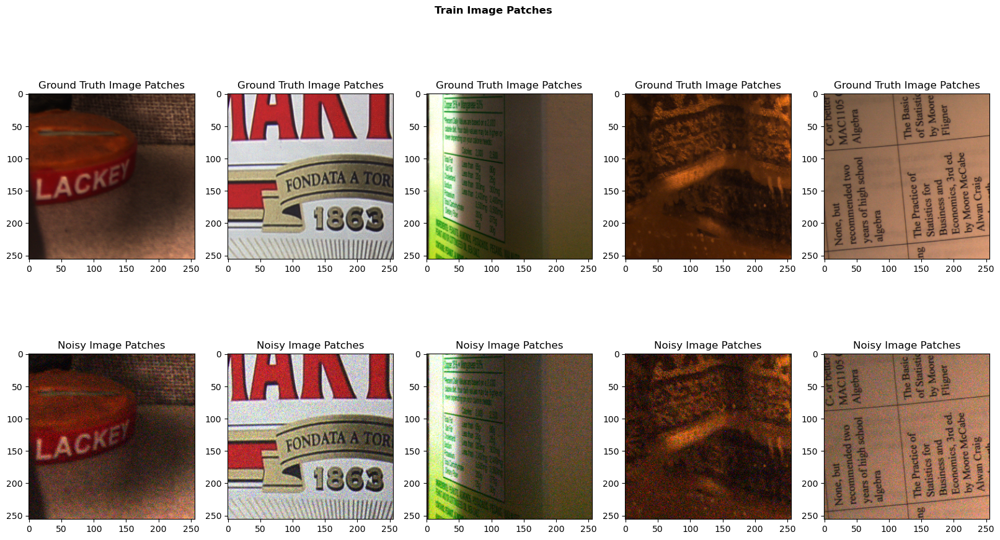

In [21]:
fig, axs = plt.subplots(2,5,figsize=(20,10))
r = random.sample(range(0, 2816), 5)

fig.suptitle('Train Image Patches',fontweight ="bold")
for i in range(5):
    axs[0][i].imshow(y_train[r[i]])
    axs[0][i].set_title('Ground Truth Image Patches')
    axs[1][i].imshow(X_train[r[i]])
    axs[1][i].set_title('Noisy Image Patches')

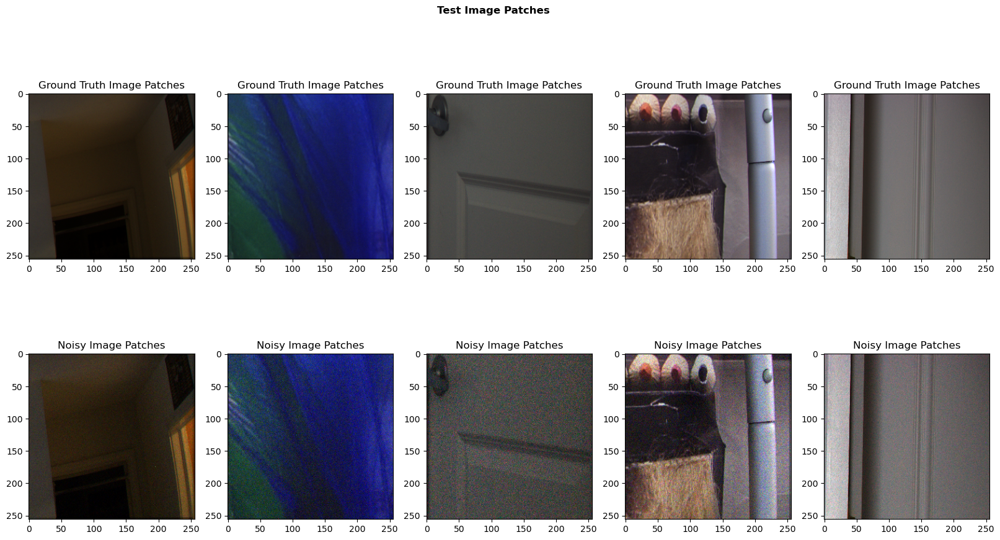

In [22]:
fig, axs = plt.subplots(2,5,figsize=(20,10))
r = random.sample(range(0, 720), 5)

fig.suptitle('Test Image Patches',fontweight ="bold")
for i in range(5):
  axs[0][i].imshow(y_test[r[i]])
  axs[0][i].set_title('Ground Truth Image Patches')
  axs[1][i].imshow(X_test[r[i]])
  axs[1][i].set_title('Noisy Image Patches')

In [23]:
print("Total number of image patches on train data : ", len(X_train))
print("Total number of image patches on test data : ", len(X_test))

Total number of image patches on train data :  2816
Total number of image patches on test data :  720


After creating image patches, there are a total of 2816 image patches in train dataset and 720 image patches in test dataset.

In [24]:
# Storing the image patches as pickle files
import pickle
pickle.dump((X_train,y_train),open('train_data.pkl','wb'))
pickle.dump((X_test,y_test),open('test_data.pkl','wb'))

## Distribution of mean pixels of images

In [25]:
mean_red_gt = []
mean_blue_gt = []
mean_green_gt = []
mean_red_nsy = []
mean_blue_nsy = []
mean_green_nsy = []
for path in df['Ground Truth Images']:
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  mean_red_gt.append(np.mean(img[:,:,0]))
  mean_green_gt.append(np.mean(img[:,:,1]))
  mean_blue_gt.append(np.mean(img[:,:,2]))

for path in df['Noisy Images']:
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  mean_red_nsy.append(np.mean(img[:,:,0]))
  mean_green_nsy.append(np.mean(img[:,:,1]))
  mean_blue_nsy.append(np.mean(img[:,:,2]))

In [26]:
red_gt = pd.DataFrame()
green_gt = pd.DataFrame()
blue_gt = pd.DataFrame()
red_nsy = pd.DataFrame()
green_nsy = pd.DataFrame()
blue_nsy = pd.DataFrame()

red_gt['Mean Pixel on Ground Truth Images'] = mean_red_gt
red_gt['channel'] = 'red'
red_nsy['Mean Pixel on  Noisy Images'] = mean_red_nsy
red_nsy['channel'] = 'red'

green_gt['Mean Pixel on Ground Truth Images'] = mean_green_gt
green_gt['channel'] = 'green'
green_nsy['Mean Pixel on  Noisy Images'] = mean_green_nsy
green_nsy['channel'] = 'green'

blue_gt['Mean Pixel on Ground Truth Images'] = mean_blue_gt
blue_gt['channel'] = 'blue'
blue_nsy['Mean Pixel on  Noisy Images'] = mean_blue_nsy
blue_nsy['channel'] = 'blue'

concat_gt = pd.concat([red_gt,green_gt,blue_gt],ignore_index=True)
concat_nsy = pd.concat([red_nsy,green_nsy,blue_nsy],ignore_index=True)

/opt/conda/lib/python3.7/site-packages/seaborn/axisgrid.py:848: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)
/opt/conda/lib/python3.7/site-packages/seaborn/axisgrid.py:848: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)
/opt/conda/lib/pytho

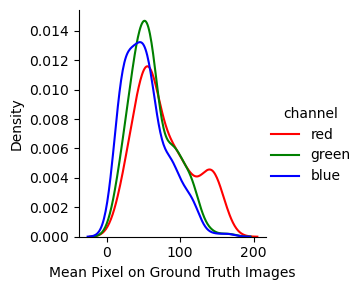

In [27]:
color = {'color': ['r', 'g', 'b']}
sns.FacetGrid(concat_gt,hue='channel',hue_kws=color).map(sns.distplot,'Mean Pixel on Ground Truth Images',hist=False).add_legend()

/opt/conda/lib/python3.7/site-packages/seaborn/axisgrid.py:848: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)
/opt/conda/lib/python3.7/site-packages/seaborn/axisgrid.py:848: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)
/opt/conda/lib/pytho

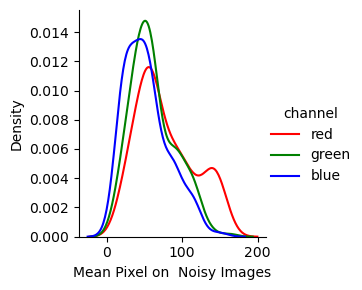

In [28]:
sns.FacetGrid(concat_nsy,hue='channel',hue_kws=color).map(sns.distplot,'Mean Pixel on  Noisy Images',hist=False).add_legend()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  after removing the cwd from sys.path.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  if __name__ == "__main__":
/opt/conda/lib/pyth

Text(0.5, 0, 'Mean Pixels')

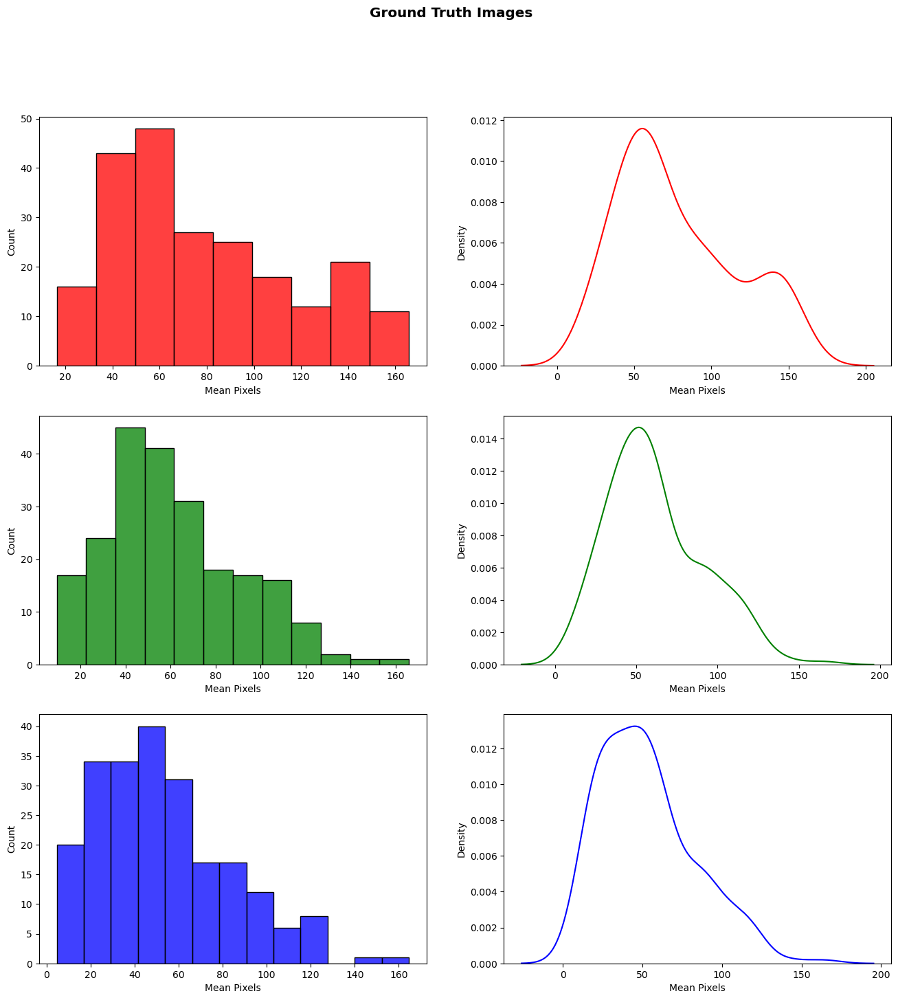

In [29]:
fig, axes = plt.subplots(3,2,figsize=(16, 16))
fig.suptitle("Ground Truth Images", fontsize = 'x-large' , fontweight = 'bold' )
sns.histplot(mean_red_gt,ax=axes[0][0],color='r')
sns.distplot(mean_red_gt,ax=axes[0][1],hist=False,color='r')
axes[0][0].set_xlabel('Mean Pixels')
axes[0][1].set_xlabel('Mean Pixels')

sns.histplot(mean_green_gt,ax=axes[1][0],color='g')
sns.distplot(mean_green_gt,ax=axes[1][1],hist=False,color='g')
axes[1][0].set_xlabel('Mean Pixels')
axes[1][1].set_xlabel('Mean Pixels')

sns.histplot(mean_blue_gt,ax=axes[2][0],color='b')
sns.distplot(mean_blue_gt,ax=axes[2][1],hist=False,color='b')
axes[2][0].set_xlabel('Mean Pixels')
axes[2][1].set_xlabel('Mean Pixels')

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  after removing the cwd from sys.path.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  if __name__ == "__main__":
/opt/conda/lib/pyth

Text(0.5, 0, 'Mean Pixels')

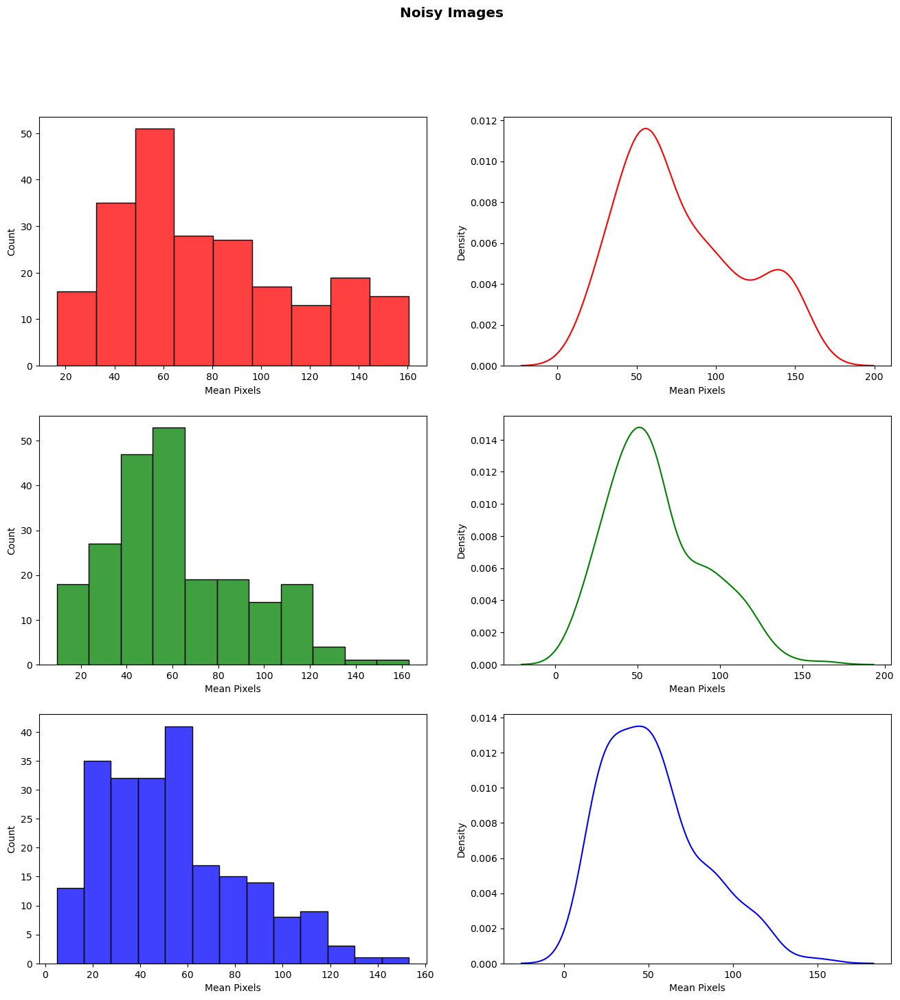

In [30]:
fig, axes = plt.subplots(3,2,figsize=(16, 16))
fig.suptitle("Noisy Images", fontsize = 'x-large' , fontweight = 'bold' )
sns.histplot(mean_red_nsy,ax=axes[0][0],color='r')
sns.distplot(mean_red_nsy,ax=axes[0][1],hist=False,color='r')
axes[0][0].set_xlabel('Mean Pixels')
axes[0][1].set_xlabel('Mean Pixels')

sns.histplot(mean_green_nsy,ax=axes[1][0],color='g')
sns.distplot(mean_green_nsy,ax=axes[1][1],hist=False,color='g')
axes[1][0].set_xlabel('Mean Pixels')
axes[1][1].set_xlabel('Mean Pixels')

sns.histplot(mean_blue_nsy,ax=axes[2][0],color='b')
sns.distplot(mean_blue_nsy,ax=axes[2][1],hist=False,color='b')
axes[2][0].set_xlabel('Mean Pixels')
axes[2][1].set_xlabel('Mean Pixels')

Observations : For most of the images (both clean and noisy), the mean pixel values ranges between 0 - 100. This means, most of the images have dark to medium brightness. Only few images have high mean pixel values or high brightness.   

##Analyzing the pixel distribution on few clean-noisy image pairs by ploting histograms 

In [31]:
sample = pd.DataFrame({'Ground Truth Images' : ['/kaggle/input/renoir/GroundTruth/129.bmp','/kaggle/input/renoir/GroundTruth/184.bmp','/kaggle/input/renoir/GroundTruth/65.bmp'], 'Noisy Images' : ['/kaggle/input/renoir/Noisy/129.bmp','/kaggle/input/renoir/Noisy/184.bmp','/kaggle/input/renoir/Noisy/65.bmp']})
sample

,Ground Truth Images,Noisy Images
0,/kaggle/input/renoir/GroundTruth/129.bmp,/kaggle/input/renoir/Noisy/129.bmp
1,/kaggle/input/renoir/GroundTruth/184.bmp,/kaggle/input/renoir/Noisy/184.bmp
2,/kaggle/input/renoir/GroundTruth/65.bmp,/kaggle/input/renoir/Noisy/65.bmp


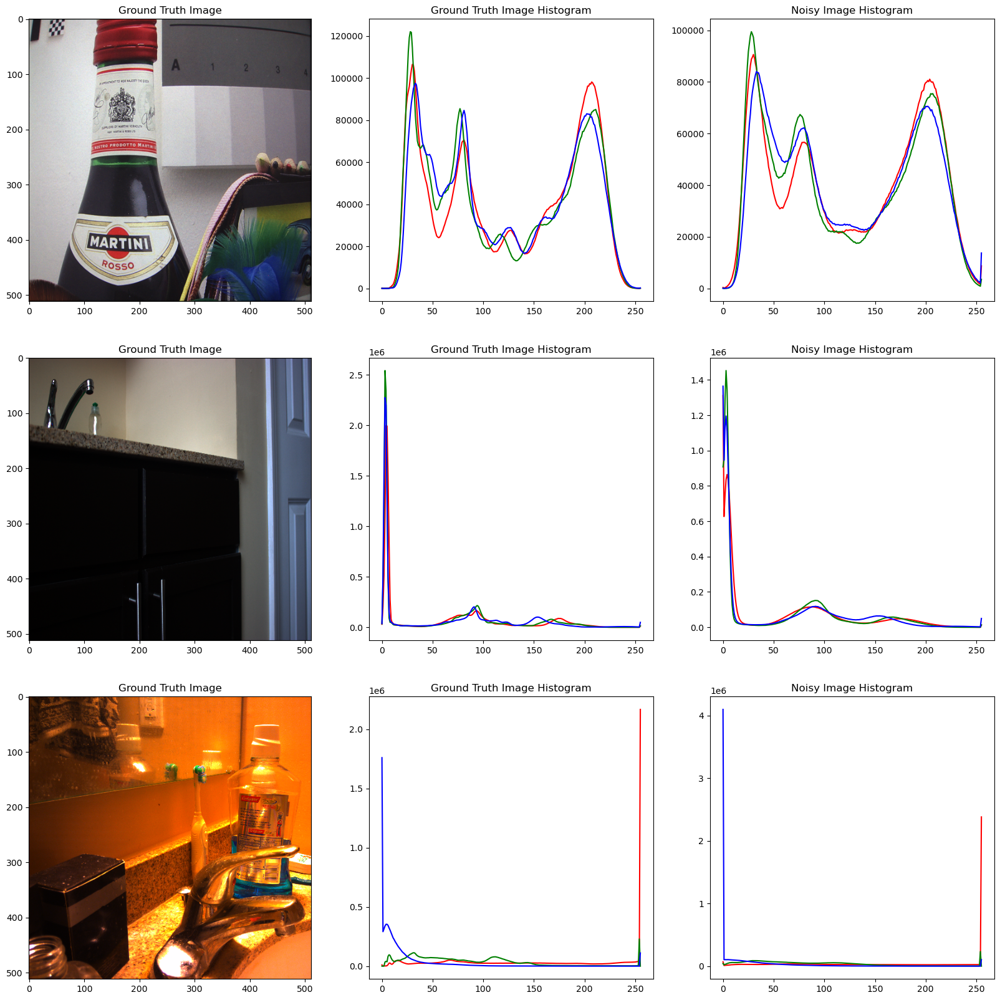

In [32]:
#https://www.geeksforgeeks.org/opencv-python-program-analyze-image-using-histogram/
fig, axes = plt.subplots(len(sample),3,figsize=(20, 20))
for i in range(len(sample)):
  path = sample['Ground Truth Images'].iloc[i]
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  resized_img = cv2.resize(img,(512,512))
  axes[i][0].imshow(resized_img)
  axes[i][0].set_title('Ground Truth Image')
  axes[i][1].plot(cv2.calcHist([img],[0],None,[256],[0,256]),color='r')
  axes[i][1].plot(cv2.calcHist([img],[1],None,[256],[0,256]),color='g')
  axes[i][1].plot(cv2.calcHist([img],[2],None,[256],[0,256]),color='b')
  axes[i][1].set_title('Ground Truth Image Histogram')

  path = sample['Noisy Images'].iloc[i]
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  axes[i][2].plot(cv2.calcHist([img],[0],None,[256],[0,256]),color='r')
  axes[i][2].plot(cv2.calcHist([img],[1],None,[256],[0,256]),color='g')
  axes[i][2].plot(cv2.calcHist([img],[2],None,[256],[0,256]),color='b')
  axes[i][2].set_title('Noisy Image Histogram')

Observation : The noisy images seems to have smoother pixel intensity distribution compared to clean images. Also many pixels in noisy images takes zero pixel value compared to the corresponding pixel values of its clean image. 

## Analyzing the PSNR and SSIM values of the images

In [33]:
from tqdm import tqdm
SSIM = [];PSNR = [];
for i in tqdm(range(len(df))):
    path = df['Ground Truth Images'].iloc[i]
    img1 = cv2.imread(path)
    img1 = img1.astype("float32") / 255.0
    path = df['Noisy Images'].iloc[i]
    img2 = cv2.imread(path)
    img2 = img2.astype("float32") / 255.0
    SSIM.append(ssim(img1,img2,multichannel=True,data_range=img2.max() - img2.min()))
    PSNR.append(psnr(img1,img2))

  0%|          | 0/221 [00:00<?, ?it/s]/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  # Remove the CWD from sys.path while we load stuff.
100%|██████████| 221/221 [21:48<00:00,  5.92s/it]


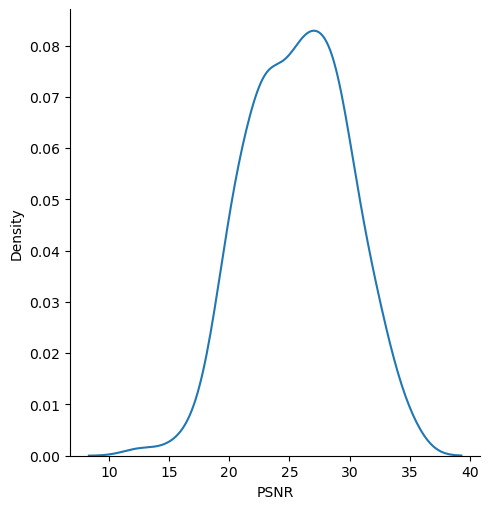

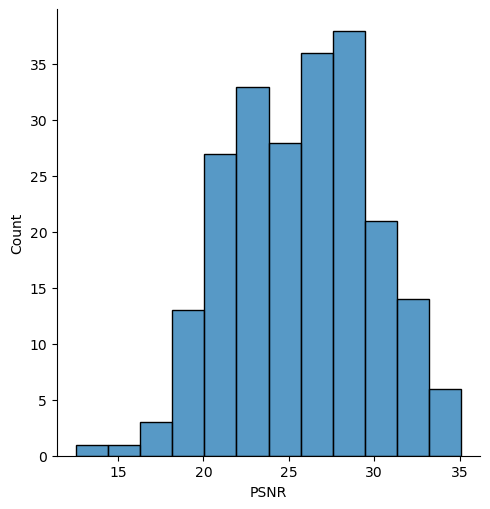

In [34]:
ax = sns.displot(PSNR,kind='kde')
ax.set(xlabel='PSNR', ylabel='Density')
ax = sns.displot(PSNR)
ax.set(xlabel='PSNR', ylabel='Count')

Observations : Majority of the clean-noisy image pairs have PSNR value between 25-30. So, a good denoising model should give PSNR value greater than 30 (approx) for majority of the images.

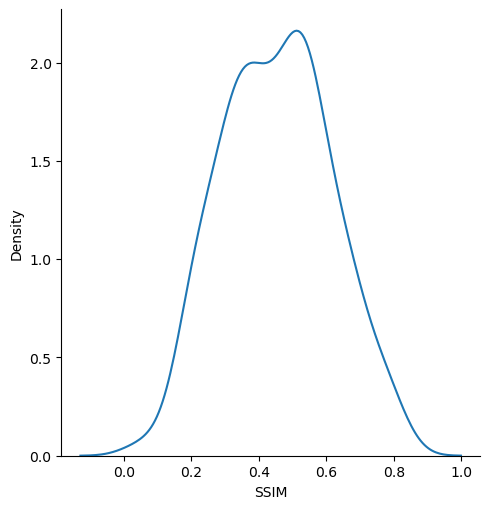

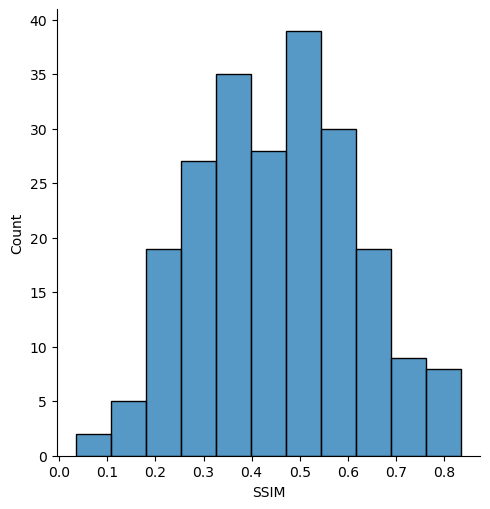

In [35]:
ax = sns.displot(SSIM,kind='kde')
ax.set(xlabel='SSIM', ylabel='Density')
ax = sns.displot(SSIM)
ax.set(xlabel='SSIM', ylabel='Count')

Observations:<br>
As you can see, the NLM filter is able to denoise the images to some extent. But it smoothens many details that are present in the ground truth images leading to loss of important informations that should have been retained. Also, when noise is too high NLM fails to provide good results. <br>

Thus we can conclude, there is a need of using more advanced deep learning techniques for image denoising tasks. 

# Creating Dataset for modeling using custom data generators in Keras 

In [36]:
X_train_patches, y_train_patches = pickle.load(open('/kaggle/working/train_data.pkl', 'rb'))
X_test_patches,y_test_patches = pickle.load(open('/kaggle/working/test_data.pkl', 'rb'))

In [37]:
print(X_train_patches.shape)
print(y_train_patches.shape)
print(X_test_patches.shape)
print(y_test_patches.shape)

(2816, 256, 256, 3)
(2816, 256, 256, 3)
(720, 256, 256, 3)
(720, 256, 256, 3)


In [38]:
#Normalizing the image pixels
X_train_patches = X_train_patches.astype("float32") / 255.0
y_train_patches = y_train_patches.astype("float32") / 255.0
X_test_patches = X_test_patches.astype("float32") / 255.0
y_test_patches = y_test_patches.astype("float32") / 255.0

In [39]:
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, X,y,batch_size=1, shuffle=False):
        self.X = X
        self.y = y
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(X))

    def __getitem__(self, i):
        # collect batch data
        batch_x = self.X[i * self.batch_size : (i+1) * self.batch_size]
        batch_y = self.y[i * self.batch_size : (i+1) * self.batch_size]
        
        return tuple((batch_x,batch_y))
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [40]:
batch_size=32
train_dataloader = Dataloder(X_train_patches,y_train_patches, batch_size, shuffle=True)
test_dataloader = Dataloder(X_test_patches,y_test_patches,batch_size, shuffle=True)

In [41]:
train_dataloader[0][0].shape

(32, 256, 256, 3)

# Some plotting and prediction functions that can be used for all model

In [42]:
# Custom function to get denoised image prediction for noisy images
def prediction(img,model):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(1024,1024))
    img = img.astype("float32") / 255.0
    img_patches = patches(img,256)
    nsy=[]
    for i in range(4):
        for j in range(4):
            nsy.append(img_patches[i][j][0])
    nsy = np.array(nsy)
    pred_img = model.predict(nsy)
    pred_img = np.reshape(pred_img,(4,4,1,256,256,3))
    pred_img = unpatchify(pred_img, img.shape)
    return pred_img

In [43]:
# Custom function to get denoised image prediction for noisy images on quantized models using tflite
def prediction_tflite(img,model):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(1024,1024))
    img = img.astype("float32") / 255.0
    img_patches = patches(img,256)
    nsy=[]
    for i in range(4):
        for j in range(4):
            nsy.append(img_patches[i][j][0])
    nsy = np.array(nsy)
    pred=[]
    for patch in nsy:
        model.set_tensor(input_details[0]['index'], tf.expand_dims(patch,axis=0))
        model.invoke()
        tflite_model_predictions = model.get_tensor(output_details[0]['index'])
        pred.append(tflite_model_predictions)
    pred_img = np.reshape(pred,(4,4,1,256,256,3))
    pred_img = unpatchify(pred_img, img.shape)
    return pred_img

In [44]:
# Custom function to plot/visualize noisy, ground truth and predicted images
def visualize(sample,model):
    fig,ax = plt.subplots(len(sample),3,figsize=(30,30))
    for i in range(len(sample)):
        path = sample['Ground Truth Images'].iloc[i]
        test_img_gt = cv2.imread(path)
        test_img_gt = cv2.cvtColor(test_img_gt, cv2.COLOR_BGR2RGB)
        test_img_gt = cv2.resize(test_img_gt,(512,512))
        test_img_gt = test_img_gt.astype("float32") / 255.0

        path = sample['Noisy Images'].iloc[i]
        test_img_nsy = cv2.imread(path)
        pred_img = prediction(test_img_nsy,model)
        pred_img = cv2.resize(pred_img,(512,512))
        test_img_nsy = cv2.cvtColor(test_img_nsy, cv2.COLOR_BGR2RGB)
        test_img_nsy = cv2.resize(test_img_nsy,(512,512))
        test_img_nsy = test_img_nsy.astype("float32") / 255.0
        ax[i][0].imshow(test_img_nsy)
        ax[i][0].get_xaxis().set_visible(False)
        ax[i][0].get_yaxis().set_visible(False)
        ax[i][0].title.set_text("Noisy Image")
        ax[i][1].imshow(test_img_gt)
        ax[i][1].get_xaxis().set_visible(False)
        ax[i][1].get_yaxis().set_visible(False)
        ax[i][1].title.set_text("Ground Truth Image")
        ax[i][2].imshow(pred_img)
        ax[i][2].get_xaxis().set_visible(False)
        ax[i][2].get_yaxis().set_visible(False)
        ax[i][2].title.set_text("Predicted Image")

In [45]:
# Custom function that computes the psnr and ssim values for images
def psnr_and_ssim(X_test,y_test,model,model_type='Normal'):
    psnr_nsy = 0.0
    psnr_de_nsy = 0.0
    ssim_nsy = 0.0
    ssim_de_nsy = 0.0
    for i in range(len(X_test)):
        #getting the noisy images
        path = X_test.iloc[i]
        nsy = cv2.imread(path)  
        #getting the predicted images
        if model_type == 'Quantized': 
            pred = prediction_tflite(nsy,model)
        else:
            pred = prediction(nsy,model)
        #getting the ground truth images
        path = y_test.iloc[i]
        gt = cv2.imread(path)         
        gt = cv2.cvtColor(gt, cv2.COLOR_BGR2RGB)
        #Resizing the images
        gt = cv2.resize(gt,(1024,1024))
        nsy = cv2.resize(nsy,(1024,1024))
        #Normalizing the images
        gt = gt.astype("float32") / 255.0
        nsy = nsy.astype("float32") / 255.0
        #Computing psnr and ssim for test images
        psnr_nsy += psnr(gt,nsy)
        psnr_de_nsy += psnr(gt,pred)
        ssim_nsy += ssim(gt,nsy,multichannel=True,data_range=nsy.max() - nsy.min())
        ssim_de_nsy += ssim(gt,pred,multichannel=True,data_range=pred.max() - pred.min())
    psnr_nsy = psnr_nsy/len(X_test)
    psnr_de_nsy = psnr_de_nsy/len(X_test)
    ssim_nsy = ssim_nsy/len(X_test)
    ssim_de_nsy = ssim_de_nsy/len(X_test)
    return psnr_nsy, psnr_de_nsy,ssim_nsy,ssim_de_nsy

# RIDNet
The RIDNet architecture is as shown below :
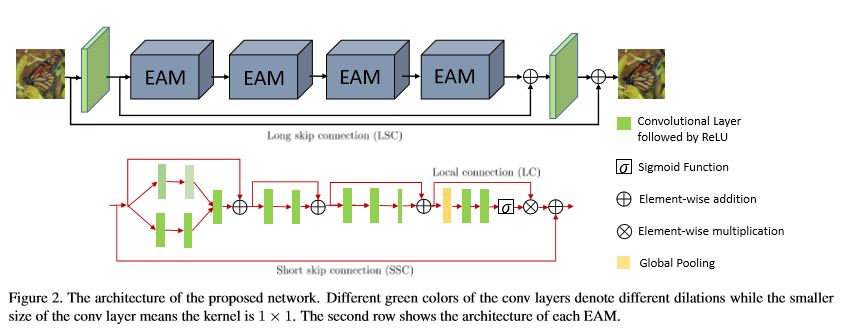

In the research paper, they trained the model using synthetically added noisy images and real noisy image datasets such as  RENOIR, Poly etc. They also performed data augmentation on these images with rotations of 90, 180, 270 degrees and horizontal flip. <br>
The loss function used for training the model is mean absolute error. <br>

Refer the research paper for detailed explanation : https://arxiv.org/pdf/1904.07396v2.pdf

Modifications done for RIDNet implementation compared to research paper :
1. Will be using only real noisy image datasets. (RENOIR)
2. The loss function that will be used is mean squared error instead of mean absolute error. 
3. Training for huge number of iterations is not feasible as done in the research paper. Will try to get the best performance within the limitations of system configurations.


In [46]:
#https://github.com/saeed-anwar/RIDNet
#In the above reference code, short skip connection in EAM network and skip conncetions in the overall network was not included. I will be adding those as well.   
class EAM(tf.keras.layers.Layer):
    def __init__(self,**kwargs):
        super().__init__(**kwargs)
        self.conv1 = Conv2D(64, (3,3), dilation_rate=1,padding='same',activation='relu')
        self.conv2 = Conv2D(64, (3,3), dilation_rate=2,padding='same',activation='relu') 
        self.conv3 = Conv2D(64, (3,3), dilation_rate=3,padding='same',activation='relu')
        self.conv4 = Conv2D(64, (3,3), dilation_rate=4,padding='same',activation='relu')
        self.conv5 = Conv2D(64, (3,3),padding='same',activation='relu')
        self.conv6 = Conv2D(64, (3,3),padding='same',activation='relu')
        self.conv7 = Conv2D(64, (3,3),padding='same')
        self.conv8 = Conv2D(64, (3,3),padding='same',activation='relu')
        self.conv9 = Conv2D(64, (3,3),padding='same',activation='relu')
        self.conv10 = Conv2D(64, (1,1),padding='same')
        self.gap = GlobalAveragePooling2D()
        self.conv11 = Conv2D(64, (3,3),padding='same',activation='relu')
        self.conv12 = Conv2D(64, (3,3),padding='same',activation='sigmoid')
    def call(self,input):
        conv1 = self.conv1(input)
        conv1 = self.conv2(conv1)
        conv2 = self.conv3(input)
        conv2 = self.conv4(conv2)
        concat = concatenate([conv1,conv2])
        conv3 = self.conv5(concat)
        add1 = Add()([input,conv3])
        conv4 = self.conv6(add1)
        conv4 = self.conv7(conv4)
        add2 = Add()([conv4,add1])
        add2 = Activation('relu')(add2)
        conv5 = self.conv8(add2)
        conv5 = self.conv9(conv5)
        conv5 = self.conv10(conv5)
        add3 = Add()([add2,conv5])
        add3 = Activation('relu')(add3)
        gap = self.gap(add3)
        gap = Reshape((1,1,64))(gap)
        conv6 = self.conv11(gap)
        conv6 = self.conv12(conv6)
        mul = Multiply()([conv6, add3])
        out = Add()([input,mul]) # This is not included in the reference code
        return out

In [47]:
tf.keras.backend.clear_session()
input = Input(shape=(256, 256, 3))

conv1 = Conv2D(64, (3,3),padding='same')(input)
eam1 = EAM()(conv1)
eam2 = EAM()(eam1)
eam3 = EAM()(eam2)
eam4 = EAM()(eam3)
#add = Add()([eam4,conv1])  
conv2 = Conv2D(3, (3,3),padding='same')(eam4)
out = Add()([conv2,input])

RIDNet = Model(input,out)
RIDNet.compile(optimizer=tf.keras.optimizers.Adam(1e-03), loss=tf.keras.losses.MeanSquaredError())
RIDNet.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 eam (EAM)                      (None, 256, 256, 64  447232      ['conv2d[0][0]']                 
                                )                                                             

In [48]:
batch_size=8
train_dataloader = Dataloder(X_train_patches,y_train_patches, batch_size, shuffle=True)
test_dataloader = Dataloder(X_test_patches,y_test_patches,batch_size, shuffle=True)

In [49]:
log_dir="logs/model_4"
tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)
reducelr = ReduceLROnPlateau(monitor='val_loss', factor=0.1,verbose=1,patience=4,min_delta=0.00001)
callback = [tensorboard,reducelr]
RIDNet.fit(train_dataloader,shuffle=True,epochs=20,validation_data= test_dataloader, callbacks=callback)

Epoch 1/20
352/352 [==============================] - 322s 847ms/step - loss: 0.0357 - val_loss: 0.0018 - lr: 0.0010
Epoch 2/20
352/352 [==============================] - 297s 844ms/step - loss: 9.0390e-04 - val_loss: 0.0010 - lr: 0.0010
Epoch 3/20
352/352 [==============================] - 297s 845ms/step - loss: 8.1413e-04 - val_loss: 7.4651e-04 - lr: 0.0010
Epoch 4/20
352/352 [==============================] - 297s 845ms/step - loss: 7.5403e-04 - val_loss: 6.4532e-04 - lr: 0.0010
Epoch 5/20
352/352 [==============================] - 297s 845ms/step - loss: 7.0564e-04 - val_loss: 6.0117e-04 - lr: 0.0010
Epoch 6/20
352/352 [==============================] - 297s 844ms/step - loss: 7.1290e-04 - val_loss: 6.1327e-04 - lr: 0.0010
Epoch 7/20
352/352 [==============================] - 297s 845ms/step - loss: 6.6580e-04 - val_loss: 6.0709e-04 - lr: 0.0010
Epoch 8/20
352/352 [==============================] - 297s 844ms/step - loss: 6.8392e-04 - val_loss: 5.9825e-04 - lr: 0.0010
Epoch 9/20
3

In [50]:
RIDNet.fit(train_dataloader,shuffle=True,epochs=25,initial_epoch=20,validation_data= test_dataloader, callbacks=callback)

Epoch 21/25
352/352 [==============================] - 297s 844ms/step - loss: 5.0987e-04 - val_loss: 4.9967e-04 - lr: 1.0000e-05
Epoch 22/25
352/352 [==============================] - 297s 844ms/step - loss: 5.0978e-04 - val_loss: 4.9745e-04 - lr: 1.0000e-05
Epoch 23/25
352/352 [==============================] - 297s 844ms/step - loss: 5.0916e-04 - val_loss: 4.9704e-04 - lr: 1.0000e-05
Epoch 24/25
352/352 [==============================] - 297s 844ms/step - loss: 5.0803e-04 - val_loss: 4.9668e-04 - lr: 1.0000e-05
Epoch 25/25
352/352 [==============================] - ETA: 0s - loss: 5.0788e-04
Epoch 25: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
352/352 [==============================] - 297s 844ms/step - loss: 5.0788e-04 - val_loss: 4.9624e-04 - lr: 1.0000e-05


In [51]:
RIDNet.save('RIDNet.h5')

In [54]:
RIDNet = tf.keras.models.load_model('/kaggle/working/RIDNet.h5',custom_objects={'EAM':EAM})

In [55]:
sample = pd.DataFrame({'Ground Truth Images' :['/kaggle/input/renoir/GroundTruth/29.bmp','/kaggle/input/renoir/GroundTruth/84.bmp','/kaggle/input/renoir/GroundTruth/18.bmp'], "Noisy Images" : ['/kaggle/input/renoir/GroundTruth/29.bmp','/kaggle/input/renoir/GroundTruth/84.bmp','/kaggle/input/renoir/GroundTruth/18.bmp']})
sample

,Ground Truth Images,Noisy Images
0,/kaggle/input/renoir/GroundTruth/29.bmp,/kaggle/input/renoir/GroundTruth/29.bmp
1,/kaggle/input/renoir/GroundTruth/84.bmp,/kaggle/input/renoir/GroundTruth/84.bmp
2,/kaggle/input/renoir/GroundTruth/18.bmp,/kaggle/input/renoir/GroundTruth/18.bmp


1/1 [==============================] - 0s 32ms/step


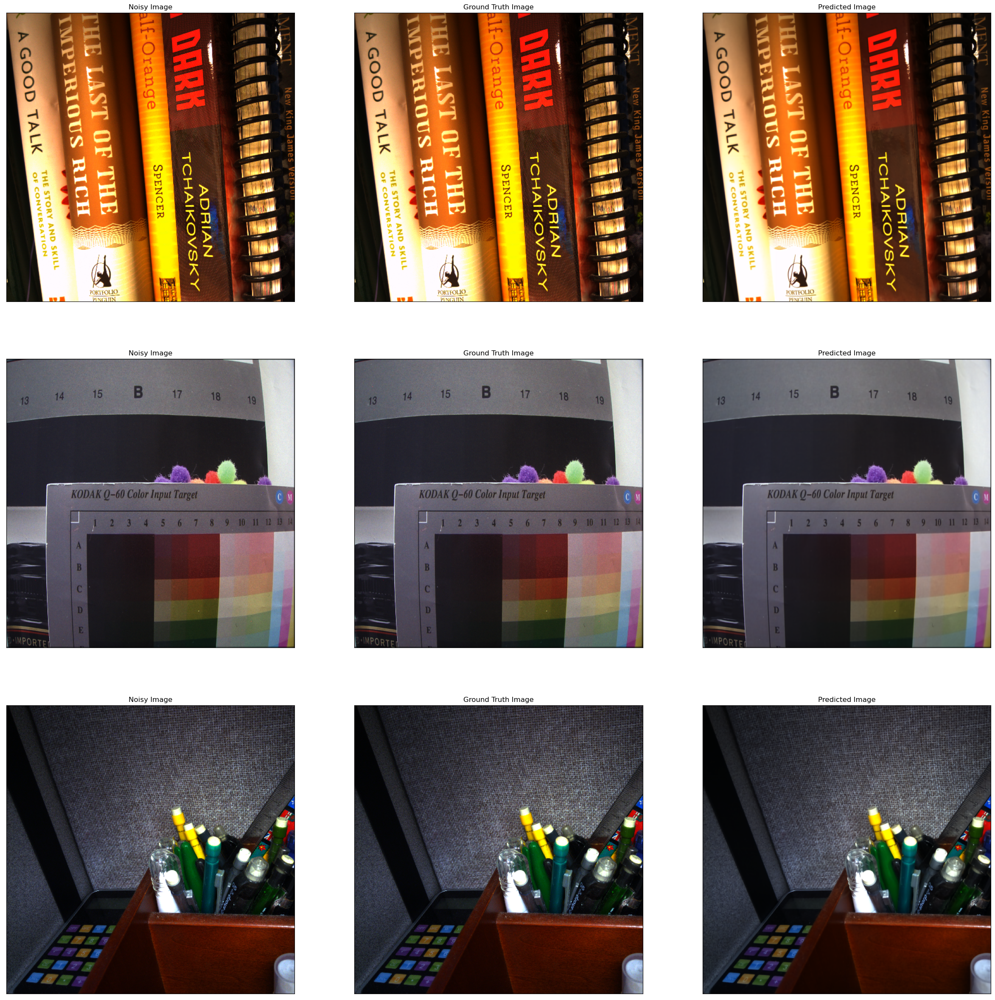

In [56]:
visualize(sample,RIDNet)

In [59]:
X_train, y_train = pickle.load(open('/kaggle/working/train_path.pkl', 'rb'))
X_test,y_test = pickle.load(open('/kaggle/working/test_path.pkl', 'rb'))

In [60]:
psnr_nsy, psnr_de_nsy, ssim_nsy, ssim_de_nsy = psnr_and_ssim(X_test,y_test,RIDNet)
print('PSNR before denoising :', psnr_nsy)
print('PSNR after denoising :', psnr_de_nsy)
print('SSIM before denoising :', ssim_nsy)
print('SSIM after denoising :', ssim_de_nsy)

1/1 [==============================] - 0s 60ms/step


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:29: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:30: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.


1/1 [==============================] - 0s 33ms/step
PSNR before denoising : 18.023695075471387
PSNR after denoising : 34.31722214877401
SSIM before denoising : 0.45323650572035046
SSIM after denoising : 0.8716890745692782


In [61]:
%tensorboard --logdir "/content/logs/model_4"

# Overall Model Performance Results 

In [63]:
from prettytable import PrettyTable
x = PrettyTable()
PSNR,SSIM=[18.023,27.247,34.317],[0.453,0.708,0.871]
PSNR_imp,SSIM_imp=[None,27.247-18.023,34.317-18.023],[None,0.708-0.453,0.871-0.453]
x.add_column("Model", ['Original clean-noisy image pairs (No model)','Autoencoder','RIDNet'])
x.add_column('PSNR',PSNR)
x.add_column('SSIM',SSIM)
x.add_column('PSNR Improvement',PSNR_imp)
x.add_column('SSIM Improvement',SSIM_imp)
print(x)

+---------------------------------------------+--------+-------+------------------+---------------------+
|                    Model                    |  PSNR  |  SSIM | PSNR Improvement |   SSIM Improvement  |
+---------------------------------------------+--------+-------+------------------+---------------------+
| Original clean-noisy image pairs (No model) | 18.023 | 0.453 |       None       |         None        |
|                 Autoencoder                 | 27.247 | 0.708 |      9.224       | 0.25499999999999995 |
|                    RIDNet                   | 34.317 | 0.871 |      16.294      |        0.418        |
+---------------------------------------------+--------+-------+------------------+---------------------+


__Conclusion :__<br>


1. RIDNet model is a more recent technique. It also gives significant improvement in model performance in terms of PSNR and SSIM values. Another advantage is that the number of parameters and model size is less compared to the other models. Thus, we can conclude RIDNet model as a better network for image denosing tasks in terms of performance and runtime. 

2. From this case study, it has been seen that, very complex network with huge number of parameters to train doesn't improve image denoising performance significantly. Whereas a more simpler network like RIDNet proves to significantly improve image denoising performance. This means that a complex model doesn't necessarily guarantees to work better in solving a problem compared to simple networks. 

3. Hence, RIDNet model gives the best results and we will take this model as final.